# notebook for trajectory analysis for the mTECII -> mTECIII lineage for discovery of terminally differentiated mTECIII with respect to cell types which were identified based on spatial associated with Hassall's
Author - Veronika Kedlian

steps: 
-  Subset mTECII and mTECIII cells 
-  Batch correct this sub lineage 
-  Annotate new subtypes based on genes that are spatially associated to HC (done in a different notebook) 
-  Perform trajectory analysis 

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import warnings 
import scipy.stats
from collections import Counter
import os

warnings.filterwarnings('ignore')
#os.chdir('/nfs/team205/ny1/ThymusSpatialAtlas/ImageSpot/')
#import scvi_wrapper as s_w
import statsmodels.api as sm

In [2]:
import scvi

Global seed set to 0


In [3]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

sc.logging.print_header()
import matplotlib.pyplot as plt
import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'pdf')
# sns.set_palette('colorblind')
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.20.3 scipy==1.8.0 pandas==1.4.2 scikit-learn==1.1.2 statsmodels==0.13.2 python-igraph==0.9.10 pynndescent==0.5.6


In [3]:
sc.settings.set_figure_params(dpi = 150, color_map = 'RdYlBu_r', dpi_save = 300, format = 'pdf',fontsize=10)

In [4]:
model_folder = '/nfs/team205/ny1/ThymusSpatialAtlas/Figure1/scvi_models/'
figures = '/nfs/team205/ny1/ThymusSpatialAtlas/Figure1/figures/'
results = '/nfs/team205/ny1/ThymusSpatialAtlas/Figure1/annotation_done/'

In [5]:
# function to run scvi 
def run_scvi2(adata, batch_hv="age_group", batch_scvi="sample", \
             cat_cov_scvi=["DonorID", "10X_version", "Sex", "Age_group"], cont_cov_scvi=["percent_mito"], \
             include_genes=[], exclude_cc_genes=True, exclude_mt_genes=True, 
             exclude_vdjgenes = True, max_epochs = 350, vae_name="", **kwargs):
    adata_scvi = sc.AnnData(X=adata.layers['counts'].copy(), obs=adata.obs.copy(), var=adata.var.copy())
    adata_scvi = adata_scvi[:,0:-150] # remove cite genes
    # adata_scvi.layers["counts"] = adata_scvi.X.copy()
    # sc.pp.normalize_total(adata_scvi, target_sum=1e4)
    # sc.pp.log1p(adata_scvi)
    # keep full dimension safe
    #    sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=10000, layer="counts",\
    #                                batch_key="Age_group")
    sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=3000, batch_key=batch_hv)
    selected_genes = list(set(adata_scvi.var.loc[adata_scvi.var['highly_variable']].index.tolist() + include_genes))
    print(len(selected_genes))
    if exclude_cc_genes:
        cell_cycle_genes = [x.strip() for x in open('/nfs/team205/vk8/processed_data/regev_lab_cell_cycle_genes.txt')]
        [selected_genes.remove(i) for i in cell_cycle_genes if i in selected_genes]
    if exclude_mt_genes:
        mt_genes = adata.var_names[adata.var_names.str.startswith('MT-')]
        [selected_genes.remove(i) for i in mt_genes if i in selected_genes]
    if exclude_vdjgenes:
        import re
        [selected_genes.remove(i) for i in selected_genes if re.search('^TR[AB][VDJ]|^IG[HKL][VDJC]', i)]
    
    adata_scvi = adata_scvi[:, selected_genes].copy()
    print(adata_scvi.shape)
    scvi.model.SCVI.setup_anndata(adata_scvi, batch_key=batch_scvi,
                                  categorical_covariate_keys=cat_cov_scvi,
                                  continuous_covariate_keys=cont_cov_scvi)
    scvi_kwargs = {k: v for k, v in kwargs.items() if k in scvi.model.SCVI.__init__.__code__.co_varnames}
    vae = scvi.model.SCVI(adata_scvi, **scvi_kwargs)
   # vae = scvi.model.SCVI(adata_scvi,n_layers=2, n_latent=30)
    train_kwargs = {k: v for k, v in kwargs.items() if k in vae.train.__code__.co_varnames}
    vae.train(**train_kwargs)
    # adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
    #   adata_raw_scvi = adata.copy()
    adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
    sc.pp.neighbors(adata_scvi, use_rep="X_scVI")
    sc.tl.leiden(adata_scvi)
    #   sc.tl.umap(adata_scvi)
    sc.tl.umap(adata_scvi)

    adata_raw_scvi = adata.copy()
    adata_raw_scvi.obsm['X_scVI'] = adata_scvi.obsm['X_scVI'].copy()
    adata_raw_scvi.obsm['X_umap'] = adata_scvi.obsm['X_umap'].copy()
    adata_raw_scvi.obsp = adata_scvi.obsp.copy()
    adata_raw_scvi.uns = adata_scvi.uns.copy()
    adata_raw_scvi.obs['leiden'] = adata_scvi.obs['leiden'].copy()

    sc.pl.umap(
        adata_raw_scvi,
        color=['annotation_level_2', 'annotation_level_3', 'doublet_score'],
        frameon=False,
        ncols=2,
    )
    sc.pl.umap(
        adata_raw_scvi,
        color=['age_group','study', 'chemistry_simple', 'donor'])
    cat_cov_str = "-".join(cat_cov_scvi)
    #    vae.save(f"/nfs/team205/vk8/scripts/scvi/Results/scvi_models/{vae_name}_scvi_batch{batch_scvi}_cat{cat_cov_str}_cont{cont_cov_scvi}_10000hvgenes_{today}", save_anndata = True)
    results = {}
    results['data'] = adata_raw_scvi
    results['vae'] = vae
    return (results)

# subset cells 

In [11]:
adata_all = sc.read(f'{results}/Thymus_Atlas_v8_postQC.h5ad')

In [180]:
adata_all.obsm.keys()

KeysView(AxisArrays with keys: X_scVI, X_umap)

In [22]:
adata_all.layers['counts'] = adata_all.X.copy()

In [64]:
adata_all.obs.loc[adata_all.obs['cell_type_level_4']=='TEC-tuft', 'age_group'].value_counts()

fetal         65
infant         0
paediatric     0
Name: age_group, dtype: int64

In [65]:
adata_all.obs.loc[adata_all.obs['cell_type_level_4']=='TEC-tuft', 'cell_type_level_2']

barcode
GSM4466780-TGGACGCGTAGCCTCG    mTEC-mimetic
GSM4466780-CTGCTGTAGCTCCTTC    mTEC-mimetic
GSM4466780-CTCGGGATCCTTGCCA    mTEC-mimetic
GSM4466780-CCTTTCTAGCTAACTC    mTEC-mimetic
GSM4466780-AACTCTTAGATGTTAG    mTEC-mimetic
GSM4466780-TCTGAGACAACTTGAC    mTEC-mimetic
GSM4466780-TCATTTGCAGCATACT    mTEC-mimetic
GSM4466780-TTCGGTCGTGACAAAT    mTEC-mimetic
GSM4466780-CGAGCCACAGCGAACA    mTEC-mimetic
GSM4466780-GGCAATTCAGTCCTTC    mTEC-mimetic
GSM4466780-CACACCTTCAAACGGG    mTEC-mimetic
GSM4466780-CATCGAACACATTCGA    mTEC-mimetic
GSM4466780-GCAGTTAGTTAAGGGC    mTEC-mimetic
GSM4466780-CTCAGAATCAGCTGGC    mTEC-mimetic
GSM4466780-GTGCTTCTCGTCACGG    mTEC-mimetic
GSM4466780-ATCGAGTAGACATAAC    mTEC-mimetic
GSM4466781-TGACTAGAGTCTCCTC    mTEC-mimetic
GSM4466781-TCTATTGTCGGTCCGA    mTEC-mimetic
GSM4466781-GTGCATAGTGCTGTAT    mTEC-mimetic
GSM4466781-GTCAAGTGTTAAGAAC    mTEC-mimetic
GSM4466781-GAAGCAGAGATGTTAG    mTEC-mimetic
GSM4466781-CTCATTATCTTGCAAG    mTEC-mimetic
GSM4466781-ACGCAGCAGCAGA

adata_mtec_ss = adata_all[(adata_all.obs['cell_type_level_2'].isin(['mTEC', 'mTEC-mimetic'])) &
                          (adata_all.obs['age_group'] != 'fetal'),].copy()

In [95]:
adata_mtec_ss = adata_all[(adata_all.obs['cell_type_level_4'].isin(['mTECII', 'mTECIII'])) &
                          (adata_all.obs['age_group'] != 'fetal'),].copy()

In [96]:
sum(adata_all.obs['cell_type_level_4'].isin(['mTECII', 'mTECIII']))

2037

# batch correct with scvi

3000
(1531, 2937)
INFO     Using batches from adata.obs["donor"]                                               
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.X                                                             
INFO     Successfully registered anndata object containing 1531 cells, 2937 vars, 8 batches, 
         1 labels, and 0 proteins. Also registered 2 extra categorical covariates and 0 extra
         continuous covariates.                                                              
INFO     Please do not further modify adata until model is trained.                          


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 400/400: 100%|██████████| 400/400 [00:14<00:00, 28.29it/s, loss=1.04e+03, v_num=1]


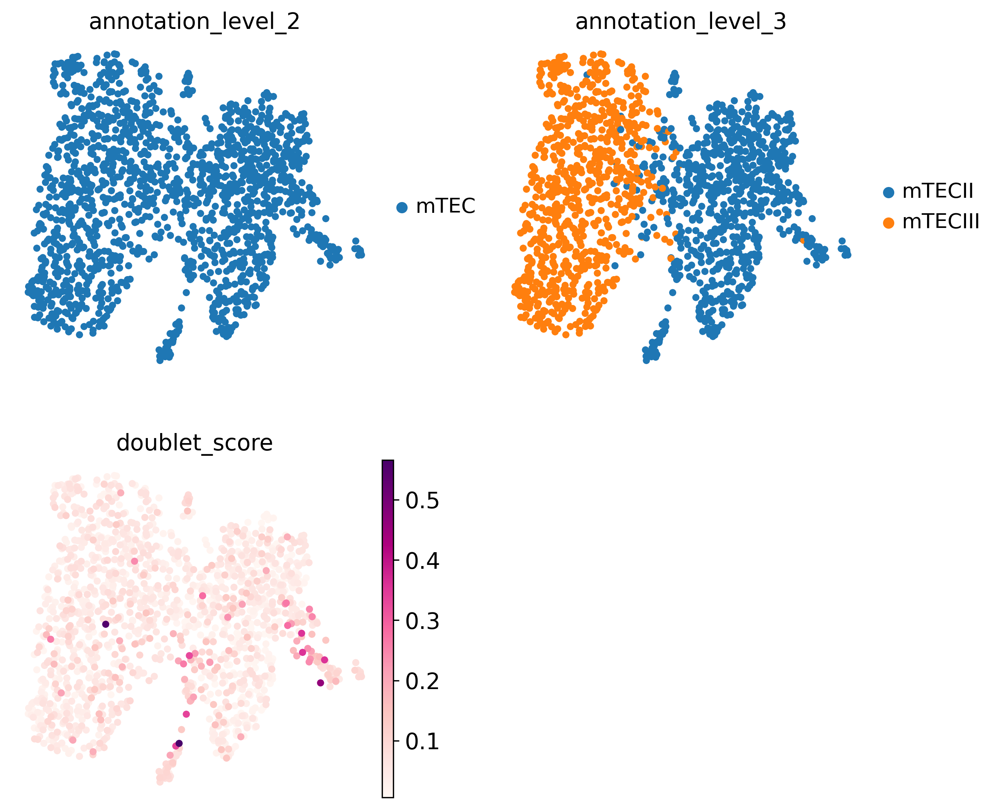

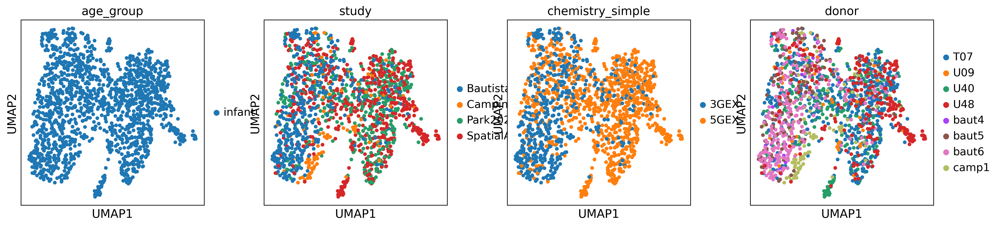

In [98]:
adata_mtec_ss_scvi_run = run_scvi2(adata_mtec_ss,  batch_hv=None, batch_scvi="donor", 
          cat_cov_scvi=['chemistry_simple','study'], cont_cov_scvi = None, include_genes=[], 
          exclude_cc_genes=True, exclude_vdjgenes=True, exclude_mt_genes = True, 
          n_layers=2, n_latent=30, max_epochs=350, batch_size=2000)

In [115]:
adata_mtec_ss = adata_mtec_ss_scvi_run['data'].copy()

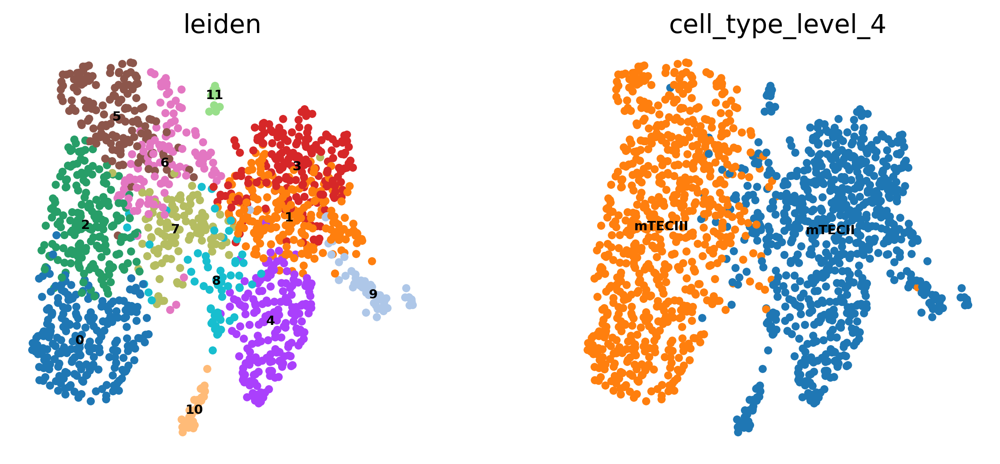

In [116]:
sc.pl.umap(adata_mtec_ss, color = ['leiden','cell_type_level_4'], frameon = False, legend_loc = "on data",
          legend_fontsize = 7)

In [117]:
def marker_gene_table(adata, cluster = 'leiden', method = 't-test_overestim_var', use_raw = True):
    sc.tl.rank_genes_groups(adata, cluster, method = method, use_raw = use_raw)
    result = adata.uns['rank_genes_groups']
    groups = result['names'].dtype.names
    if method == 't-test_overestim_var' :
        marker_tb = pd.DataFrame({group + '_' + key: result[key][group] for group in groups for key in ['names', 'pvals', 'pvals_adj', 'logfoldchanges']})
    elif method == 'logreg' :
        marker_tb = pd.DataFrame({group + '_' + key: result[key][group] for group in groups for key in ['names', 'scores']})
    else :
        print ("Method nor recognised")
   # sc.pl.rank_genes_groups_dotplot (adata, n_genes = 5)
    return marker_tb



In [118]:
sc.pp.normalize_total(adata_mtec_ss, target_sum=1e4)
sc.pp.log1p(adata_mtec_ss)

         Falling back to preprocessing with `sc.pp.pca` and default params.


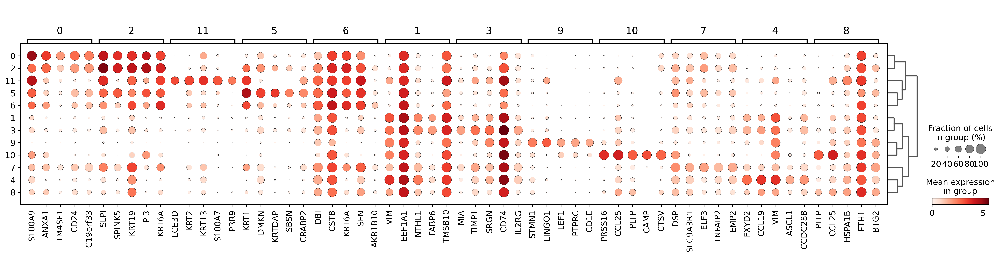

In [119]:
mtec_mrkrs = marker_gene_table(adata_mtec_ss, cluster = 'leiden', use_raw = False)
sc.pl.rank_genes_groups_dotplot (adata_mtec_ss, n_genes = 5)

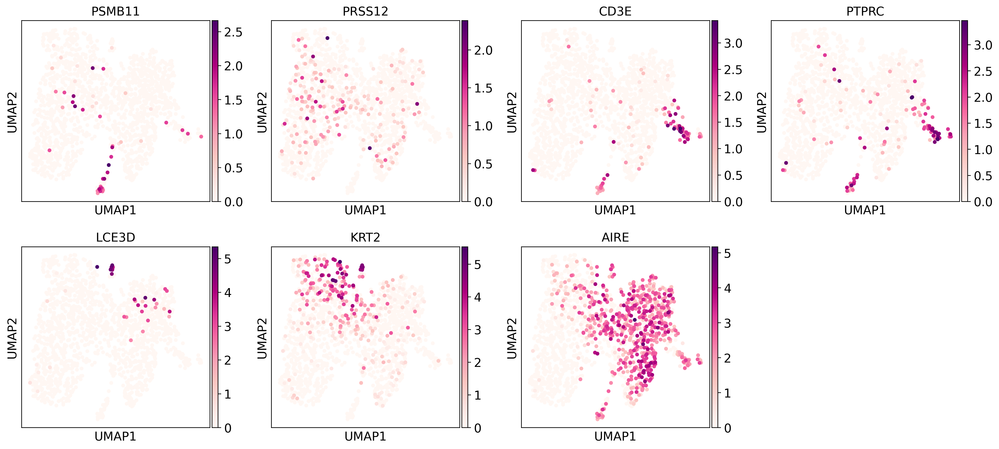

In [120]:
sc.pl.umap(adata_mtec_ss, color = ['PSMB11', 'PRSS12', 'CD3E', 'PTPRC', 'LCE3D', 
                                  'KRT2', 'AIRE'])

# remove doublets 

In [121]:
adata_mtec_ss_dbrm = adata_mtec_ss[~adata_mtec_ss.obs['leiden'].isin(['9', '10']),:].copy()

# run scvi again without doublets

3000
(1445, 2941)
INFO     Using batches from adata.obs["donor"]                                               
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.X                                                             
INFO     Successfully registered anndata object containing 1445 cells, 2941 vars, 8 batches, 
         1 labels, and 0 proteins. Also registered 2 extra categorical covariates and 0 extra
         continuous covariates.                                                              
INFO     Please do not further modify adata until model is trained.                          


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 400/400: 100%|██████████| 400/400 [00:14<00:00, 27.23it/s, loss=1.09e+03, v_num=1]


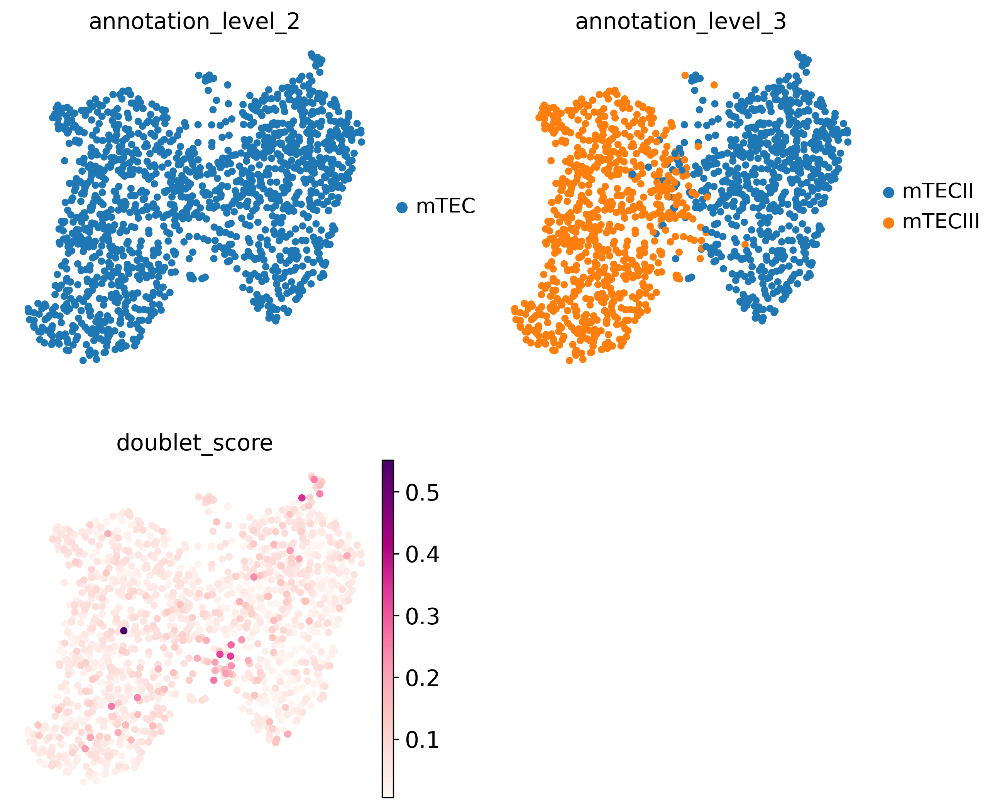

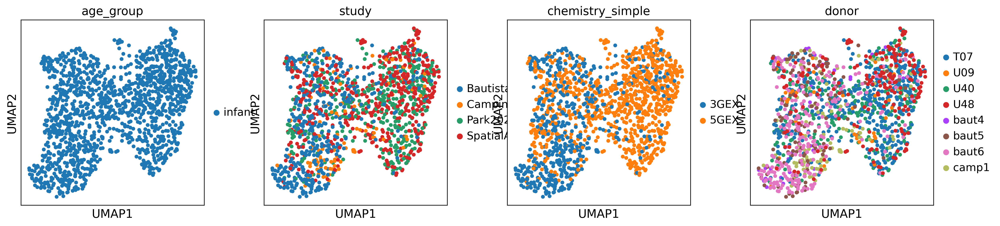

In [123]:
adata_mtec_ss_dbrm_scvi_run = run_scvi2(adata_mtec_ss_dbrm,  batch_hv=None, batch_scvi="donor", 
          cat_cov_scvi=['chemistry_simple','study'], cont_cov_scvi = None, include_genes=[], 
          exclude_cc_genes=True, exclude_vdjgenes=True, exclude_mt_genes = True, 
          n_layers=2, n_latent=30, max_epochs=350, batch_size=2000)

In [122]:
adata_mtec_ss.shape
adata_mtec_ss_dbrm.shape

(1531, 36751)

(1445, 36751)

In [124]:
adata_mtec_ss_dbrm = adata_mtec_ss_dbrm_scvi_run['data'].copy()

# annotate new cells

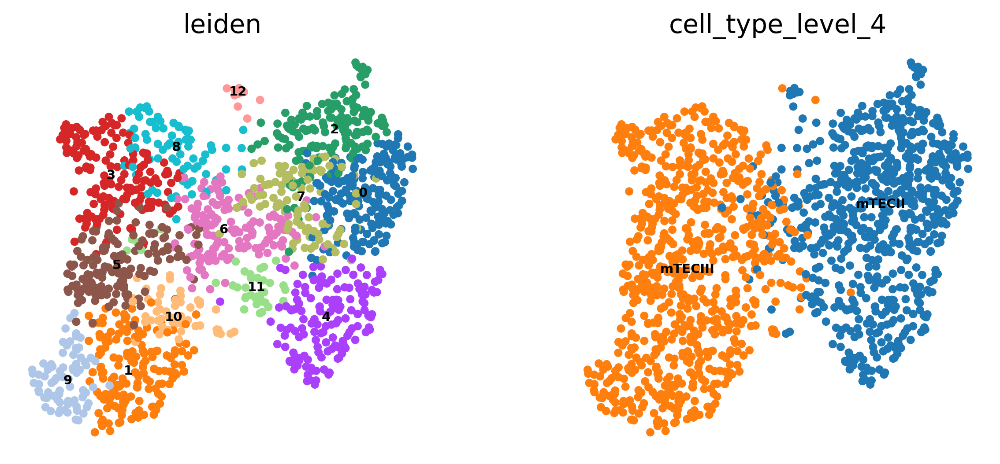

In [125]:
sc.pl.umap(adata_mtec_ss_dbrm, color = ['leiden','cell_type_level_4',], frameon = False, legend_loc = "on data",
          legend_fontsize = 7)

In [145]:
def scvi_markers(vae, cluster, n_markers=5):
    results = {}
    de_df = vae.differential_expression(
    groupby=cluster)
    de_df['cluster'] = [i.replace(" vs Rest","") for i in de_df['comparison']]
    de_df.head()
    markers = {}
    cats = vae.adata.obs[cluster].cat.categories
    for i, c in enumerate(cats):
        cid = "{} vs Rest".format(c)
        cell_type_df = de_df.loc[de_df.comparison == cid]
        cell_type_df = cell_type_df[cell_type_df.lfc_mean > 1]
        cell_type_df = cell_type_df[cell_type_df["bayes_factor"] > 2]
        cell_type_df = cell_type_df[cell_type_df["non_zeros_proportion1"] > 0.1]
        markers[c] = cell_type_df.index.tolist()[:n_markers]
    results['de_df'] = de_df
    results['markers'] = markers
    #print(results)
    return(results)


In [147]:
scvi_mrkrs = scvi_markers(adata_mtec_ss_dbrm_scvi_run['vae'], cluster = "leiden",
                          n_markers = 8)

DE...: 100%|██████████| 13/13 [00:22<00:00,  1.75s/it]


In [151]:
adata_mtec_ss_dbrm.X.data

array([0.22177207, 0.22177207, 0.22177207, ..., 3.283687  , 2.6273441 ,
       3.6765769 ], dtype=float32)

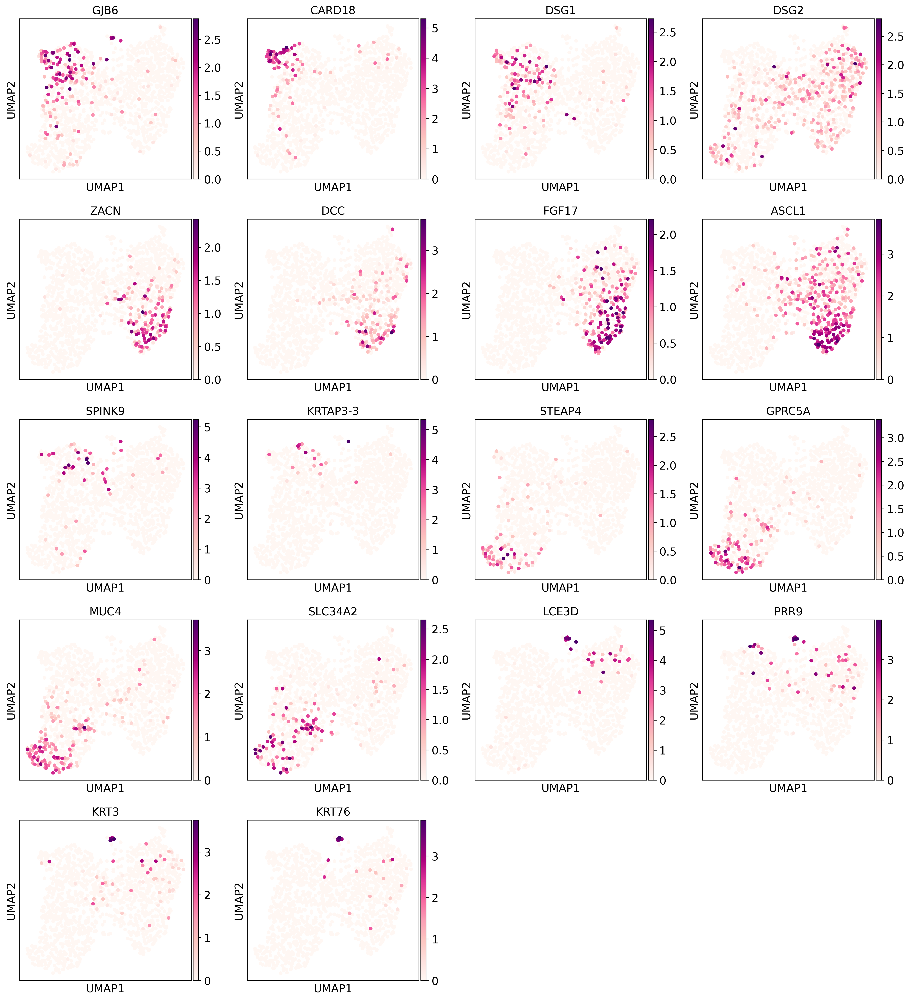

In [153]:
sc.pl.umap(adata_mtec_ss_dbrm, color = ['GJB6', 'CARD18', 'DSG1', 'DSG2', \
                                       'ZACN', 'DCC', 'FGF17', 'ASCL1',\
                                       'SPINK9', 'KRTAP3-3', 
                                       'STEAP4', 'GPRC5A', 'MUC4', 'SLC34A2',
                                       'LCE3D', 'PRR9', 'KRT3', 'KRT76'])

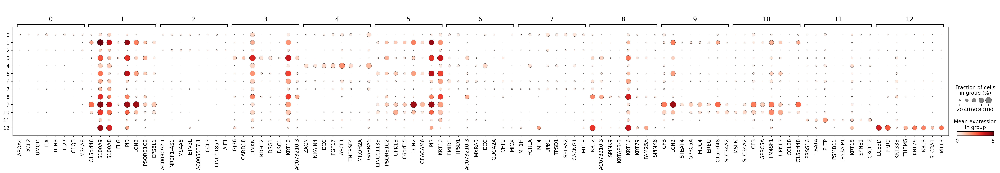

In [150]:
sc.pl.dotplot(adata_mtec_ss_dbrm, var_names = scvi_mrkrs['markers'], groupby = "leiden")

In [168]:
adata_mtec_ss_dbrm.obs['anno_manual'] = adata_mtec_ss_dbrm.obs['leiden'].apply(lambda x:
                                        'mTECII_early' if x == '4' else
                                        'mTECII_major' if x in ['0', '2', '7'] else
                                        'mTECII_trans' if x in ['11', '6'] else
                                         'mTECIII_KRT10hi' if x in ['3', '8', '12'] else
                                        'mTECIII_MUC4' if x == '9' else
                                        'mTECIII_MUC4_assoc'if x in ['10', '1'] else
                                        'mTECIII_int' if x =='5' else 'leiden'
                                                )

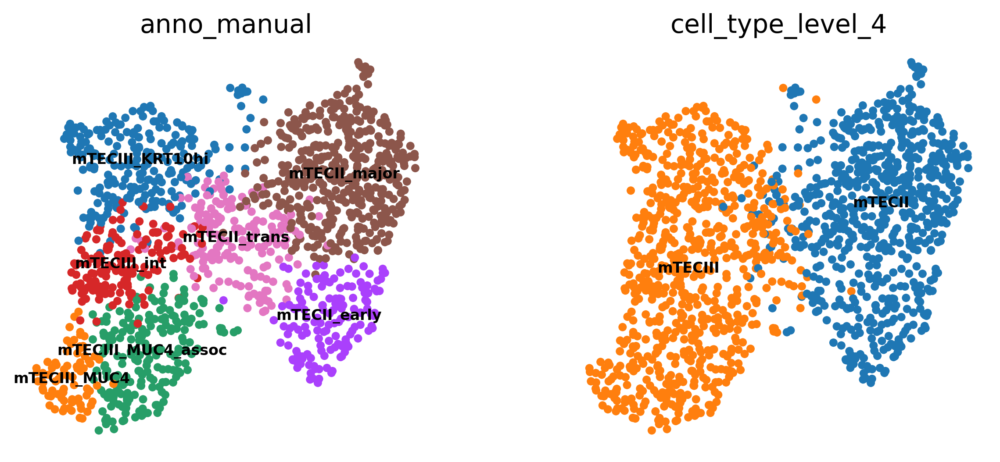

In [182]:
sc.pl.umap(adata_mtec_ss_dbrm, color=['anno_manual', 'cell_type_level_4'], 
                 legend_loc='on data', frameon = False, legend_fontsize = 8)

In [170]:
adata_mtec_ss_dbrm_scvi_run['vae'].adata.obs['anno_manual'] = adata_mtec_ss_dbrm.obs['anno_manual'].copy()

In [171]:
scvi_mrkrs2 = scvi_markers(adata_mtec_ss_dbrm_scvi_run['vae'], cluster = "anno_manual",
                          n_markers = 8)

DE...: 100%|██████████| 7/7 [00:12<00:00,  1.75s/it]


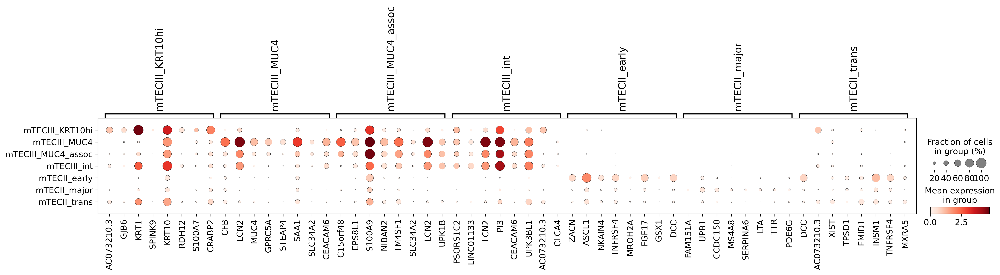

In [172]:
sc.pl.dotplot(adata_mtec_ss_dbrm, var_names = scvi_mrkrs2['markers'], groupby = "anno_manual")

# save object and model 

In [177]:
from datetime import date
today = str(date.today())

In [178]:
adata_mtec_ss_dbrm.write(f'{results}HTSA_mTECII_III_annot_{today}.h5ad')

In [179]:
adata_mtec_ss_dbrm_scvi_run['vae'].save(f'{model_folder}_HTSA_mTECII_III_annot_{today}', save_anndata = True)

# load object 

In [ ]:
import scFates as scf
import palantir


In [3]:
adata = sc.read(f'{results}/HTSA_mTECII_III_annot_2023-09-13.h5ad')

In [21]:
adata_raw = sc.read(f'{results}/HTSA_mTECII_III_annot_2023-09-13.h5ad')

In [22]:
adata_raw

AnnData object with n_obs × n_vars = 1445 × 36751
    obs: 'n_genes', 'sample_barcode', 'batch', 'chemistry', 'age_group', 'age_numeric', 'sampleID_TCRab', 'path_TCRab', 'type', 'study', 'sample', 'enrichment', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'barcode_sequence', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'status', 'assignment', 'log_prob_singleton', 'log_prob_doublet', 'louvian_1', 'louvian_05', 'latent_cell_probability', 'latent_RT_efficiency', 'log1p_n_counts', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw

In [4]:
adata.X = adata.layers['counts'].copy()

# Run palantir 

In [8]:
scvi_projections = pd.DataFrame(adata.obsm["X_scVI"],index=adata.obs_names)

In [9]:
dm_res = palantir.utils.run_diffusion_maps(scvi_projections, n_components = 30)

Determing nearest neighbor graph...
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:10)


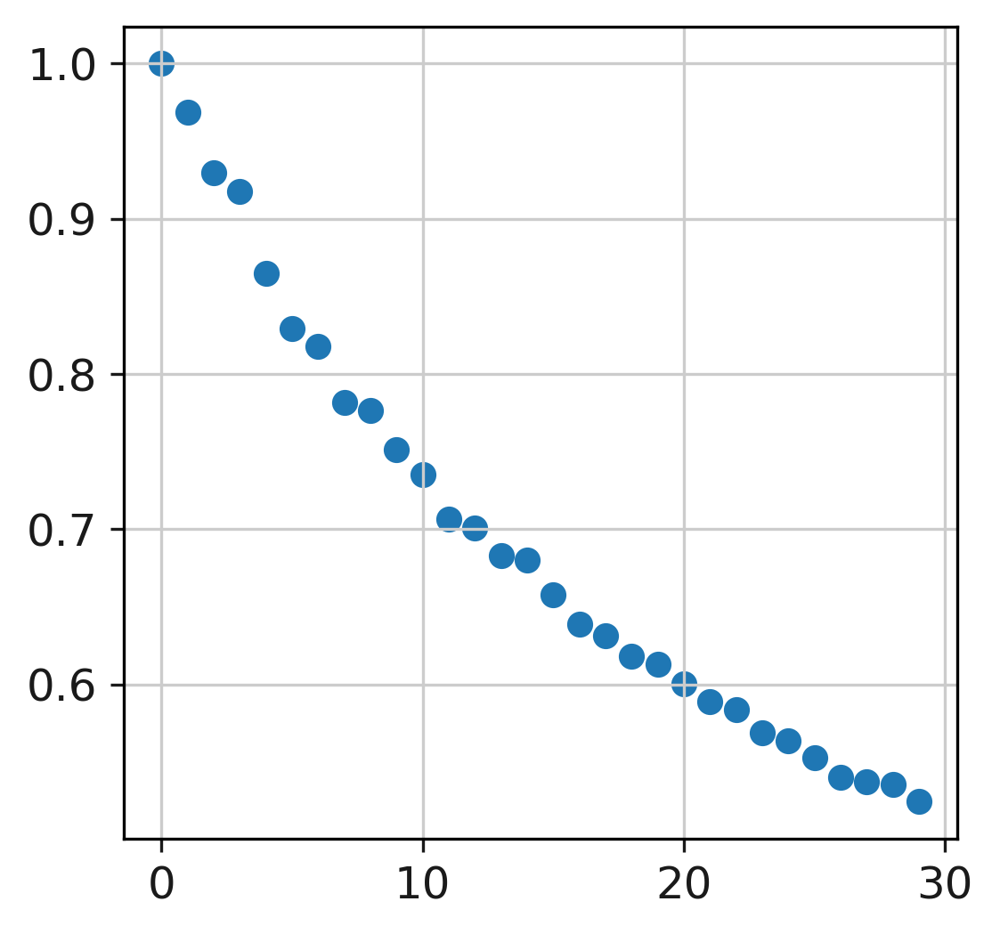

In [12]:
plt.scatter(np.arange(30), dm_res['EigenValues'])

In [13]:
ms_data = palantir.utils.determine_multiscale_space(dm_res,n_eigs=4)

In [14]:
# generate neighbor draph in multiscale diffusion space
adata.obsm["X_palantir"]=ms_data.values
sc.pp.neighbors(adata,n_neighbors=30,use_rep="X_palantir")

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [15]:
# draw ForceAtlas2 embedding using 2 first PCs as initial positions
adata.obsm["X_pca2d"]=adata.obsm["X_scVI"][:,:2]
sc.tl.draw_graph(adata,init_pos='X_scVI')

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:00:12)


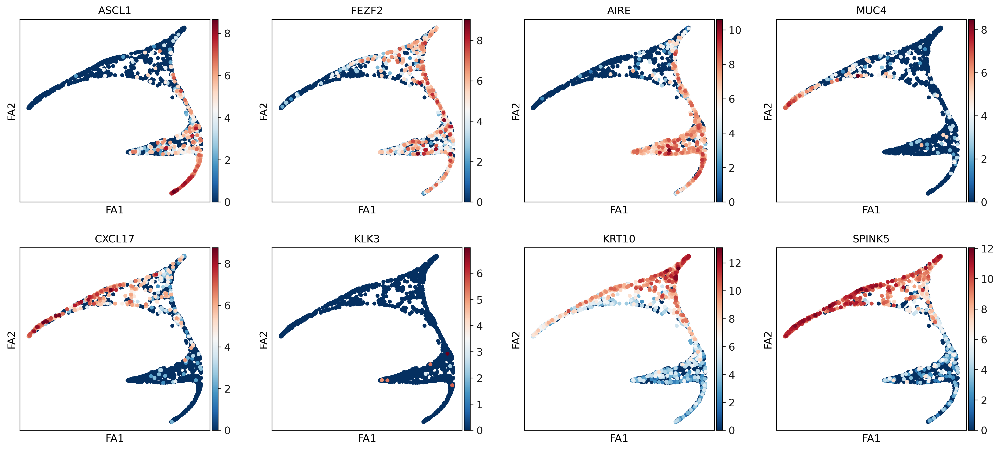

In [16]:
sc.pl.draw_graph(adata,color=["ASCL1", "FEZF2", "AIRE", "MUC4", "CXCL17", "KLK3", "KRT10", "SPINK5"],color_map="RdBu_r")

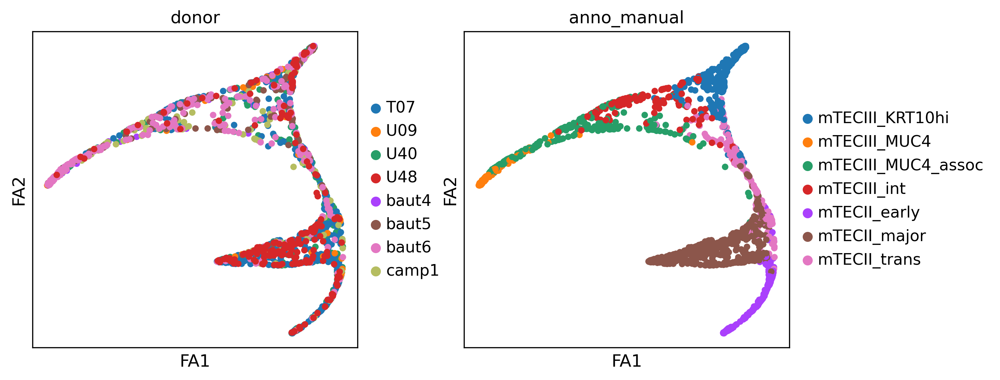

In [17]:
sc.pl.draw_graph(adata,color=["donor", "anno_manual"],color_map="RdBu_r")

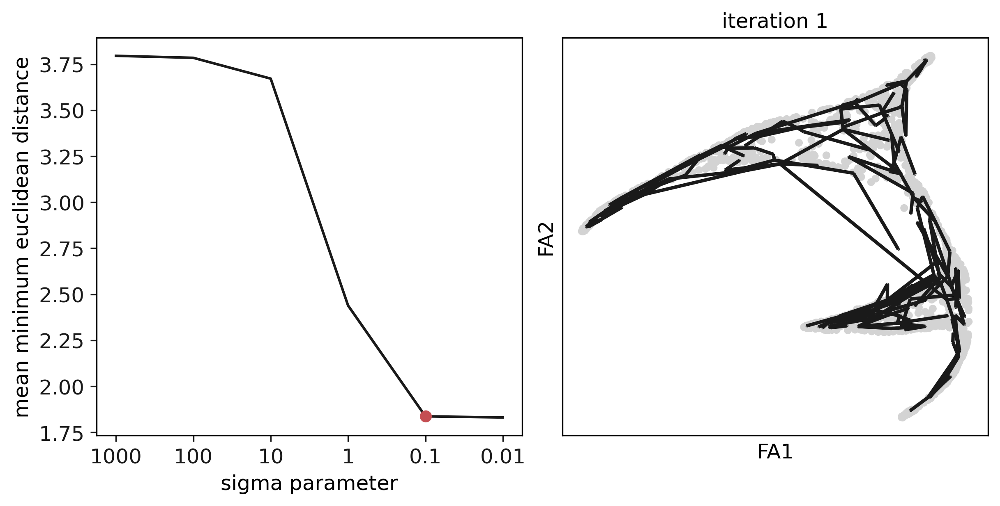

In [18]:
sig=scf.tl.explore_sigma(adata,200,"X_scVI",seed=42,plot=True)

In [19]:
scf.tl.tree(adata,method="ppt",Nodes=200,use_rep="palantir",
            device="cpu",seed=1,ppt_lambda=100,ppt_sigma=sig,ppt_nsteps=200)

inferring a principal tree --> parameters used 
    200 principal points, sigma = 0.1, lambda = 100, metric = euclidean
    fitting:  20%|██████████████████████████████▏                                                                                                                    | 41/200 [00:01<00:06, 24.66it/s]
    converged
    finished (0:00:01) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


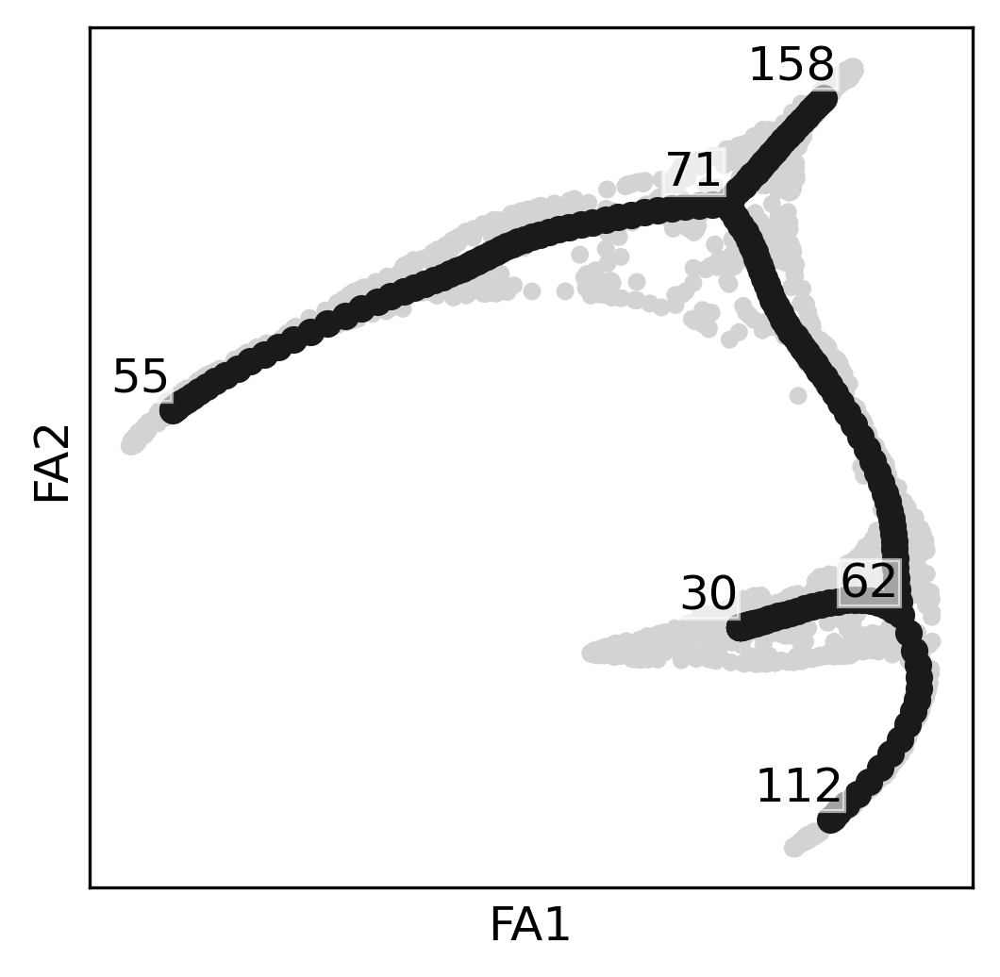

In [20]:
scf.pl.graph(adata)


In [21]:
scf.tl.root(adata,112)

node 112 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.


In [22]:
scf.tl.pseudotime(adata,n_jobs=20,n_map=100,seed=42)

projecting cells onto the principal graph
    mappings: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [01:28<00:00,  1.13it/s]
    finished (0:01:29) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


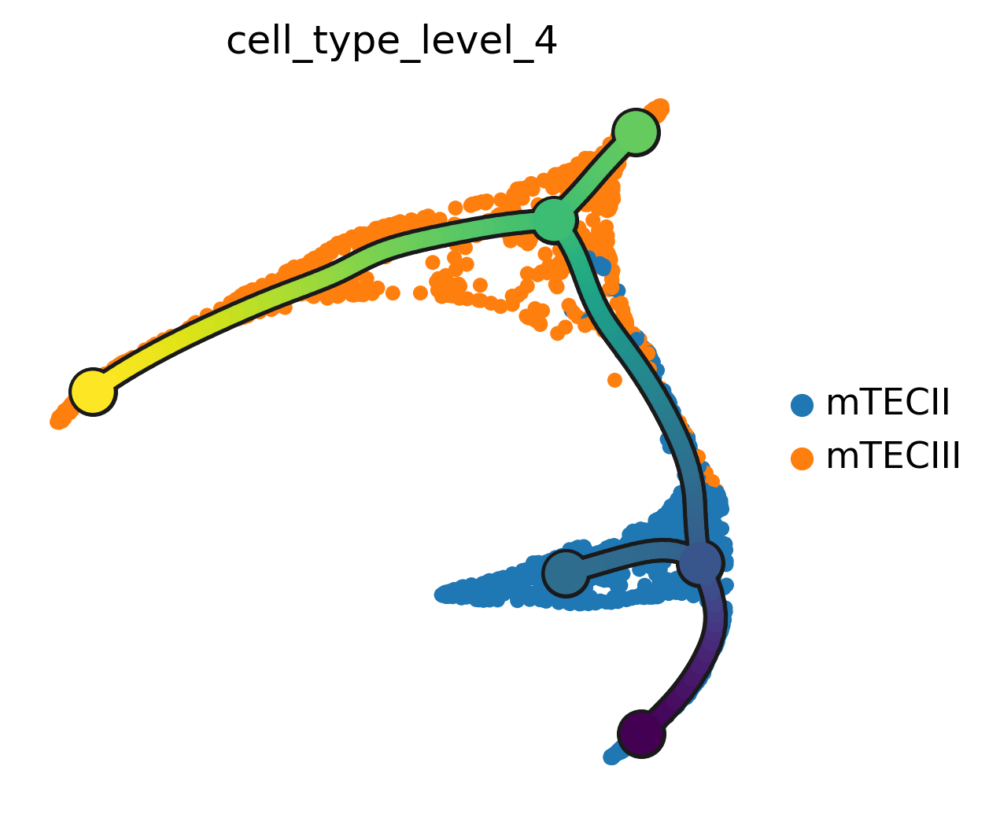

In [23]:
scf.pl.trajectory(adata, color_cells ='cell_type_level_4', frameon = False, save = "mTECII_III_trajectory_tree")

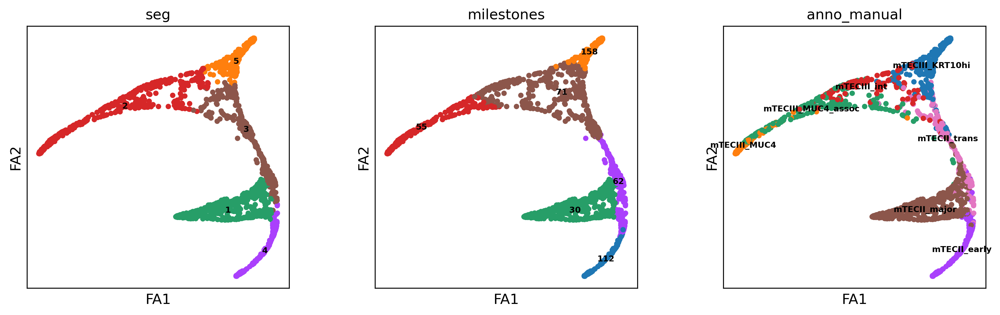

In [24]:
sc.pl.draw_graph(adata,color=["seg","milestones", "anno_manual"], color_map="RdBu_r", legend_loc = "on data",
                legend_fontsize = 7)

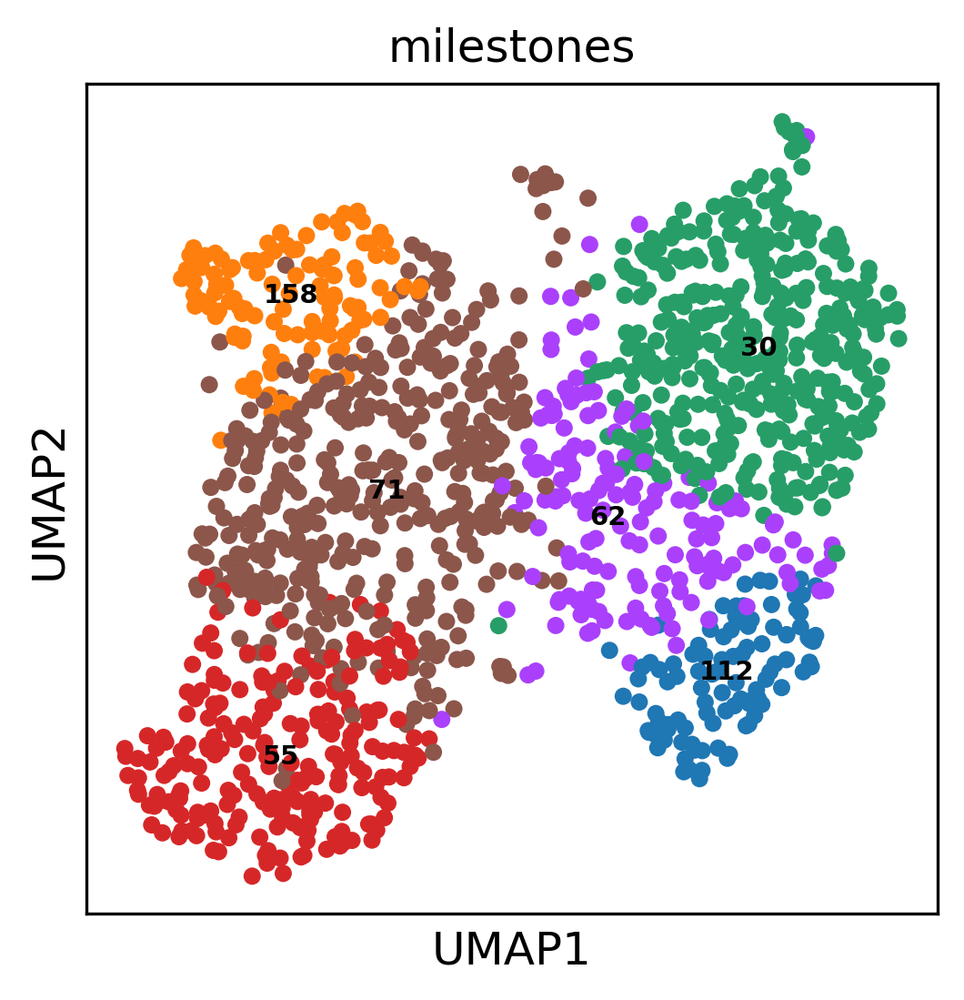

In [25]:
sc.pl.umap(adata, color = 'milestones', color_map="RdBu_r", legend_loc = "on data",
                legend_fontsize = 7)

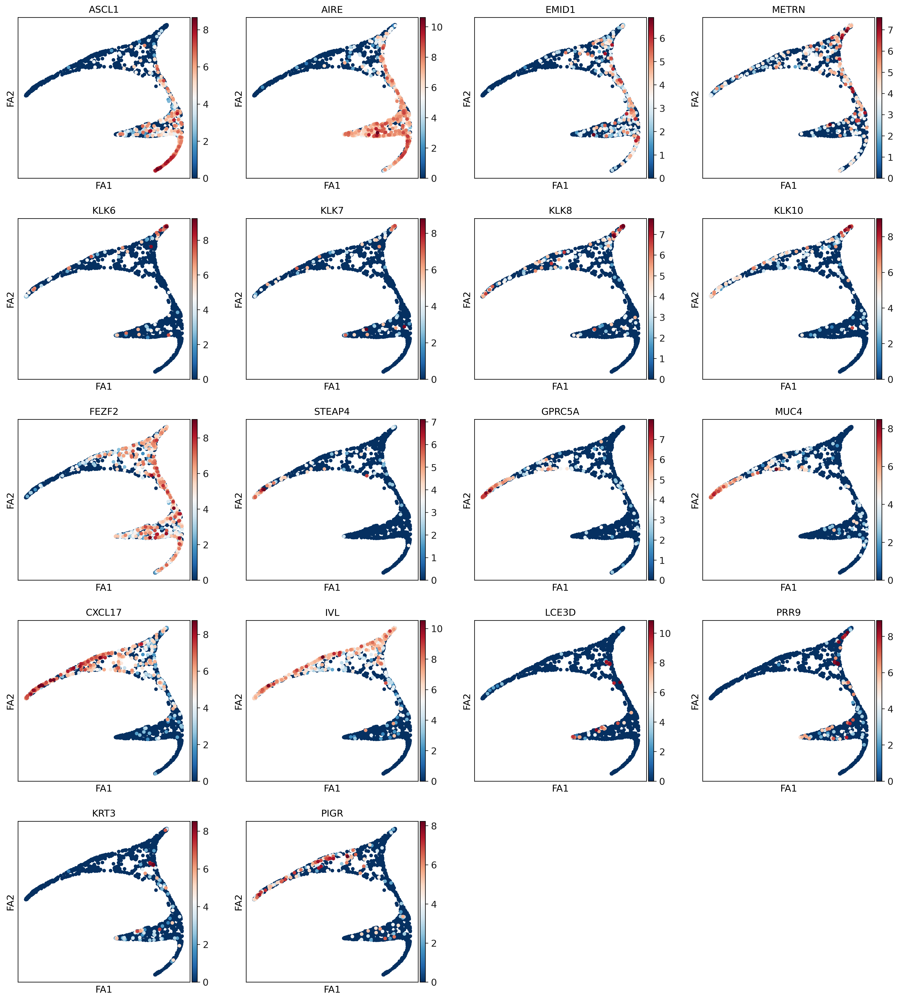

In [26]:
sc.pl.draw_graph(adata,color=['ASCL1', 'AIRE', 'EMID1', 'METRN', 'KLK6', 'KLK7', 'KLK8', 'KLK10',
                              'FEZF2', 'STEAP4', 'GPRC5A', 'MUC4', 'CXCL17', 'IVL',
                             'LCE3D', 'PRR9', 'KRT3', 'PIGR'], color_map="RdBu_r", legend_loc = "on data",
                legend_fontsize = 7)

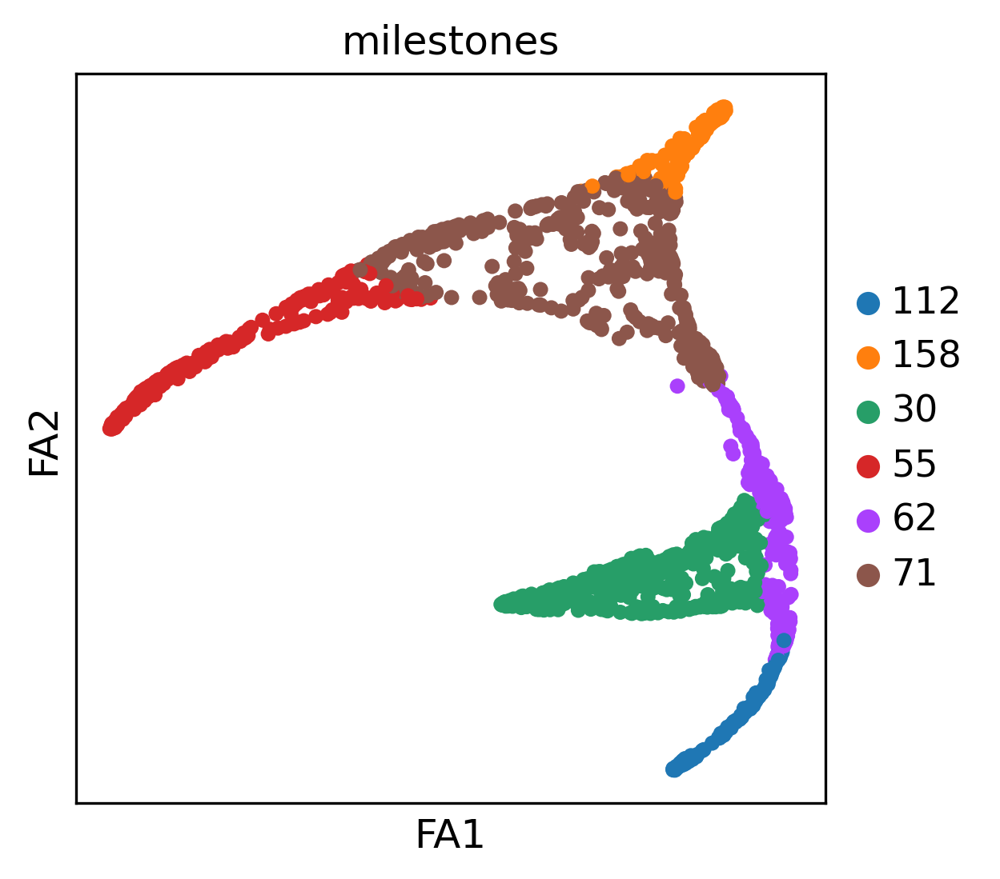

In [27]:
sc.pl.draw_graph(adata,color=["milestones"], color_map="RdBu_r")

In [28]:
scf.tl.rename_milestones(adata,["Root", "mTECIII_KRT10hi", "mTECII", "mTECIII_MUC4",
                                "mTECII_trans","mTECIII_trans"])
# we change the color of the root milestone for better visualisations
adata.uns["milestones_colors"][1]="#17bece"

In [30]:
scf.pl.milestones

<function scFates.plot.milestones.milestones(adata, basis: Union[NoneType, str] = None, annotate: bool = False, title: str = 'milestones', subset: Union[Iterable, NoneType] = None, ax=None, show: Union[bool, NoneType] = None, save: Union[str, bool, NoneType] = None, **kwargs)>

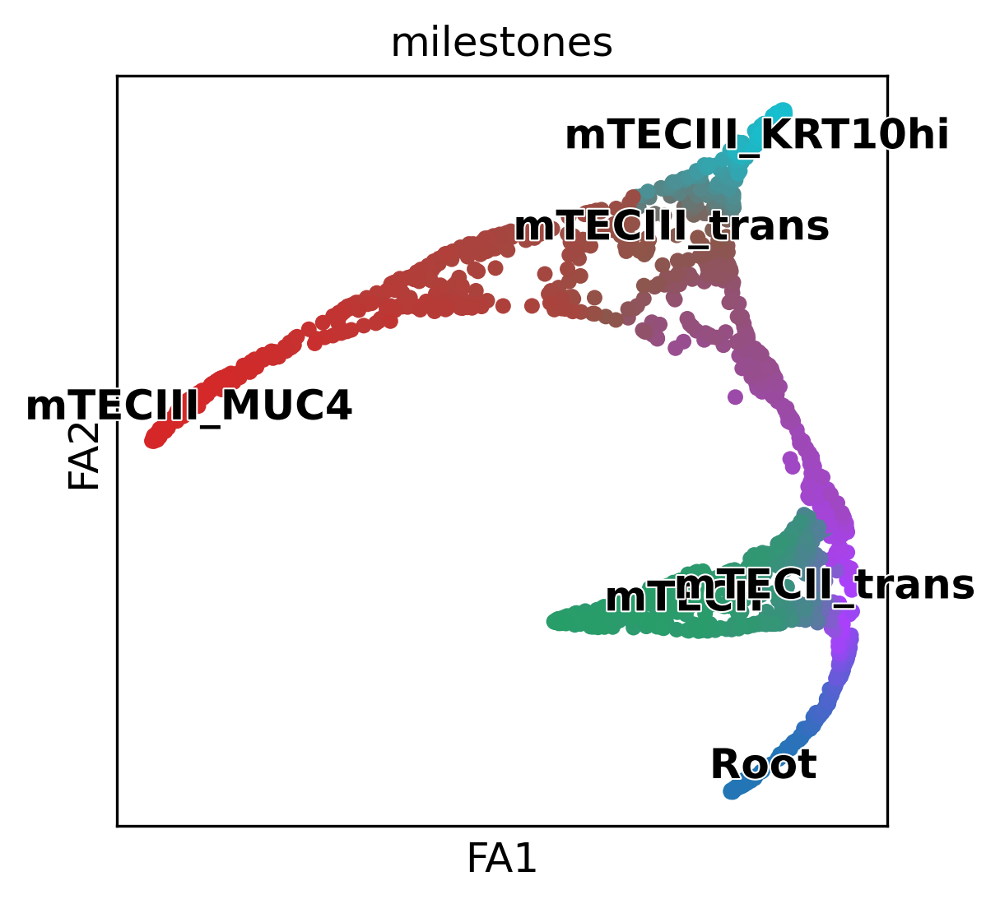

In [32]:
scf.pl.milestones(adata,annotate=True,  save = "mTECII_III_trajectory_annotated")

# generate plots for figure

# load trajectory object 

In [10]:

sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'pdf')

adata = sc.read('/nfs/team205/ny1/ThymusSpatialAtlas/Figure1/annotation_done/HTSA_mTECII_III_annot_traj2_2023-09-13.h5ad')
adata

AnnData object with n_obs × n_vars = 1445 × 3119
    obs: 'n_genes', 'sample_barcode', 'batch', 'chemistry', 'age_group', 'age_numeric', 'sampleID_TCRab', 'path_TCRab', 'type', 'study', 'sample', 'enrichment', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'barcode_sequence', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'status', 'assignment', 'log_prob_singleton', 'log_prob_doublet', 'louvian_1', 'louvian_05', 'latent_cell_probability', 'latent_RT_efficiency', 'log1p_n_counts', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw'

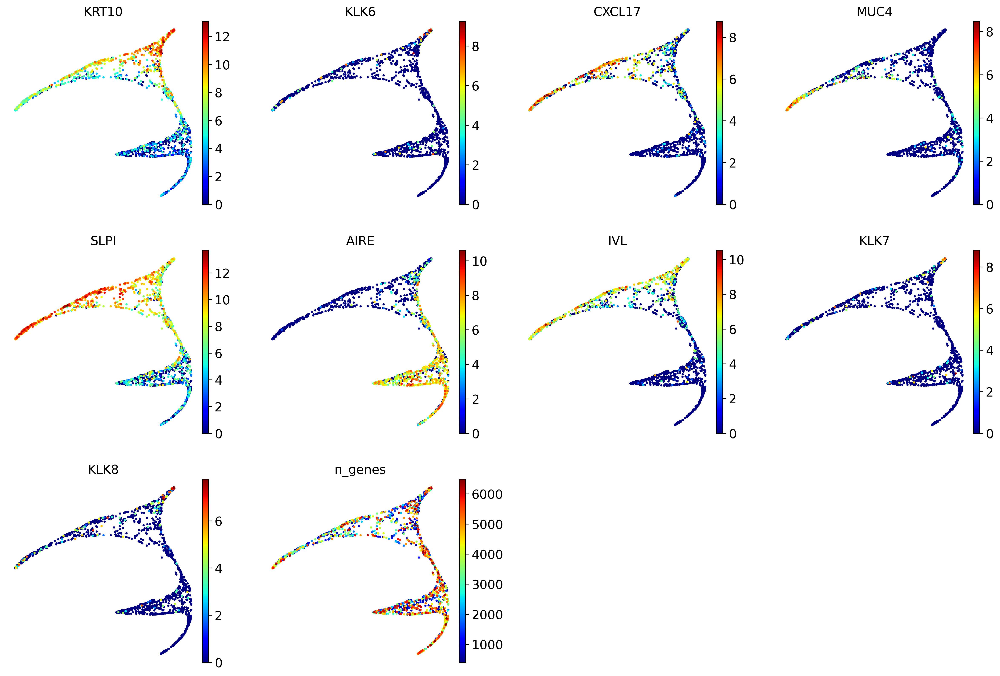

In [12]:
sc.pl.draw_graph(adata,color=['KRT10',"KLK6",'CXCL17',"MUC4",'SLPI','AIRE','IVL','KLK7','KLK8','n_genes'],color_map="jet",save='KLK_MUC_time.pdf',frameon=False,s=25)

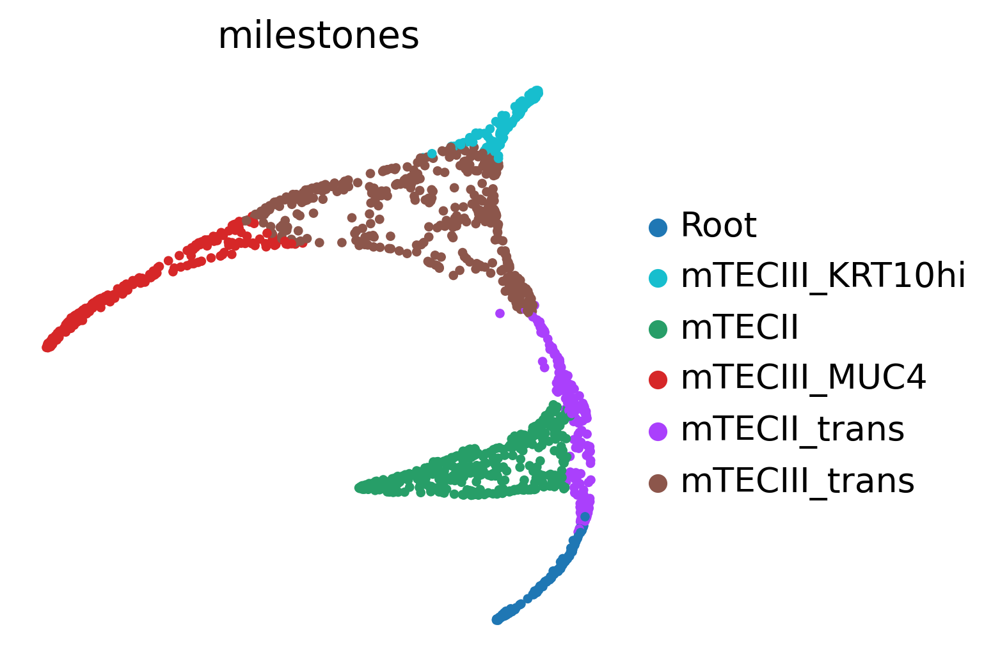

In [39]:
sc.pl.draw_graph(adata,color=['milestones'],color_map="jet",save='new_anno.pdf',s=50,frameon=False)

In [33]:
scf.tl.test_association(adata,n_jobs=20)
scf.tl.fit(adata,n_jobs=20)

test features for association with the trajectory
    single mapping : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36751/36751 [15:38<00:00, 39.16it/s]
    found 3119 significant features (0:15:39) --> added
    .var['p_val'] values from statistical test.
    .var['fdr'] corrected values from multiple testing.
    .var['st'] proportion of mapping in which feature is significant.
    .var['A'] amplitue of change of tested feature.
    .var['signi'] feature is significantly changing along pseudotime.
    .uns['stat_assoc_list'] list of fitted features on the graph for all mappings.
fit features associated with the trajectory
    single mapping : 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3119/3119 [02:02<00:00, 25.51it/s]
    finished (adata subsetted to keep only fitted features!) (0:02:04) --

In [47]:
adata.uns["graph"]["milestones"]

{'Root': 112,
 'mTECIII_KRT10hi': 158,
 'mTECII': 30,
 'mTECIII_MUC4': 55,
 'mTECII_trans': 62,
 'mTECIII_trans': 71}

In [104]:
scf.tl.test_fork(adata,root_milestone="Root",
                 milestones=["mTECIII_KRT10hi", "mTECIII_MUC4", "mTECII"],n_jobs=20,rescale=True)

testing fork
    single mapping
    Differential expression: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3119/3119 [02:13<00:00, 23.34it/s]
    test for upregulation for each leave vs root
    upreg mTECII: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1842/1842 [00:02<00:00, 666.53it/s]
    finished (0:02:19) --> added 
    .uns['Root->mTECIII_KRT10hi<>mTECIII_MUC4<>mTECII']['fork'], DataFrame with fork test results.


In [105]:
res = adata.uns['Root->mTECIII_KRT10hi<>mTECIII_MUC4<>mTECII']['fork'].copy()

In [106]:
res.loc['KLK6',:]

mTECII            -7.886823e-01
mTECIII_MUC4      -6.793808e-01
mTECIII_KRT10hi    0.000000e+00
de_p               1.168262e-01
fdr                1.000000e+00
signi_p            0.000000e+00
signi_fdr          0.000000e+00
up_A               4.048172e-01
up_p               2.154167e-10
Name: KLK6, dtype: float64

In [109]:
res.loc['KRT10',:]

mTECII            -7.436632e+00
mTECIII_MUC4      -2.957481e+00
mTECIII_KRT10hi    0.000000e+00
de_p               2.209739e-70
fdr                6.892176e-67
signi_p            1.000000e+00
signi_fdr          1.000000e+00
up_A               3.168487e+00
up_p               2.028613e-84
Name: KRT10, dtype: float64

In [107]:
res.loc['KLK7',:]

mTECII            -5.164880e-01
mTECIII_MUC4      -5.367736e-01
mTECIII_KRT10hi    0.000000e+00
de_p               9.863055e-01
fdr                1.000000e+00
signi_p            0.000000e+00
signi_fdr          0.000000e+00
up_A               3.094072e-01
up_p               1.341617e-09
Name: KLK7, dtype: float64

In [108]:
res.loc['KLK8',:]

mTECII            -1.250108e+00
mTECIII_MUC4      -8.590527e-01
mTECIII_KRT10hi    0.000000e+00
de_p               1.314488e-04
fdr                4.099889e-01
signi_p            1.000000e+00
signi_fdr          0.000000e+00
up_A               5.729061e-01
up_p               1.736276e-16
Name: KLK8, dtype: float64

In [79]:
scf.tl.branch_specific(adata,root_milestone="Root",
                 milestones=["mTECIII_KRT10hi", "mTECIII_MUC4", "mTECII"], effect=1.3)

    branch specific features: mTECIII_MUC4: 60, mTECII: 59, mTECIII_KRT10hi: 22
    finished --> updated 
    .uns['Root->mTECIII_KRT10hi<>mTECIII_MUC4<>mTECII']['fork'], DataFrame updated with additionnal 'branch' column.


In [82]:
marker_dict_1 = np.load('/nfs/team205/ny1/ThymusSpatialAtlas/Figure5/marker_genes_max_1.npy',allow_pickle=True).item()
marker_dict_2 = np.load('/nfs/team205/ny1/ThymusSpatialAtlas/Figure5/marker_genes_max_2.npy',allow_pickle=True).item()

In [85]:
sge = marker_dict_1['mTECII']+marker_dict_1['mTECIII']

In [102]:
[i for i in sge if 'KLK' in i]

['KLK6', 'KLK7', 'KLK8', 'KLK10']

In [86]:
len(sge)

104

In [87]:
sge_de_branch = [i for i in sge if i in adata.uns['Root->mTECIII_KRT10hi<>mTECIII_MUC4<>mTECII']['fork'].index.tolist()]

In [93]:
len(sge_de_branch)

31

In [81]:
adata.uns['Root->mTECIII_KRT10hi<>mTECIII_MUC4<>mTECII']['fork'].loc['MUC4',:]

mTECII                 -1.48212
mTECIII_MUC4                0.0
mTECIII_KRT10hi       -1.539528
de_p                        0.0
fdr                         0.0
signi_p                     1.0
signi_fdr                   1.0
up_A                   0.724728
up_p                        0.0
branch             mTECIII_MUC4
Name: MUC4, dtype: object

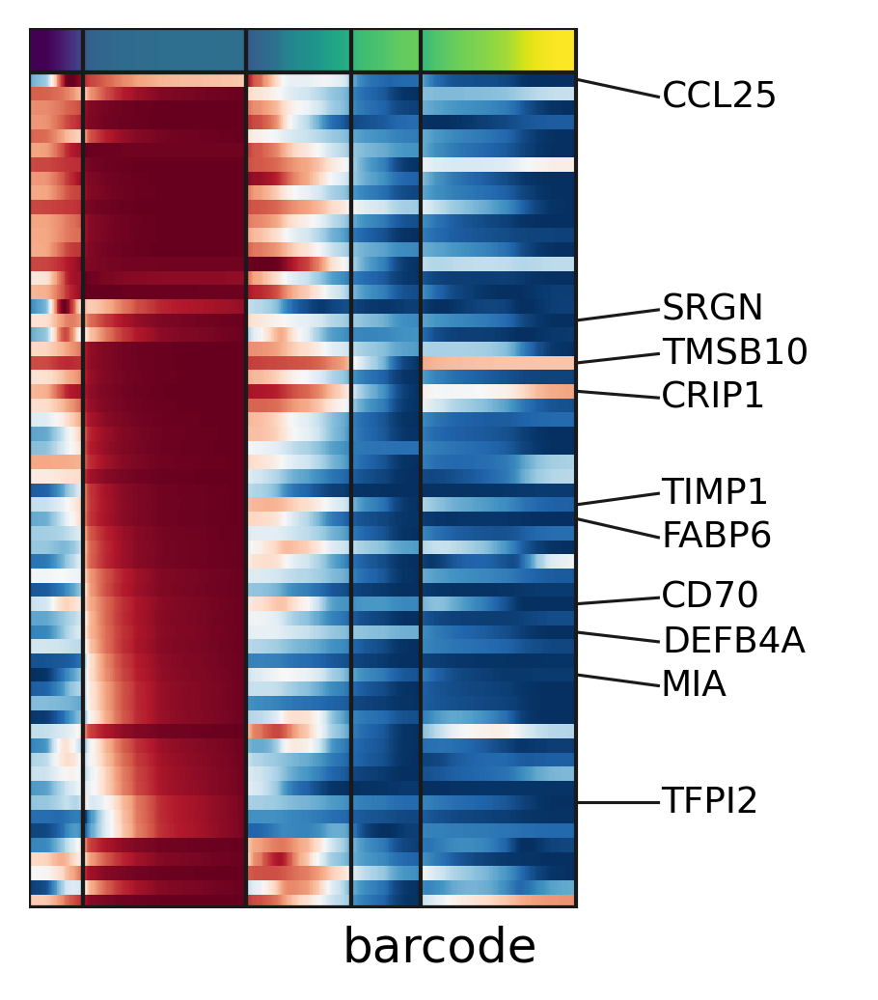

In [89]:
g1=scf.pl.trends(adata,
                 root_milestone="Root",
                 milestones=["mTECIII_KRT10hi", "mTECIII_MUC4", "mTECII"],
                 branch="mTECII",
                 plot_emb=False,ordering="max",return_genes=True)

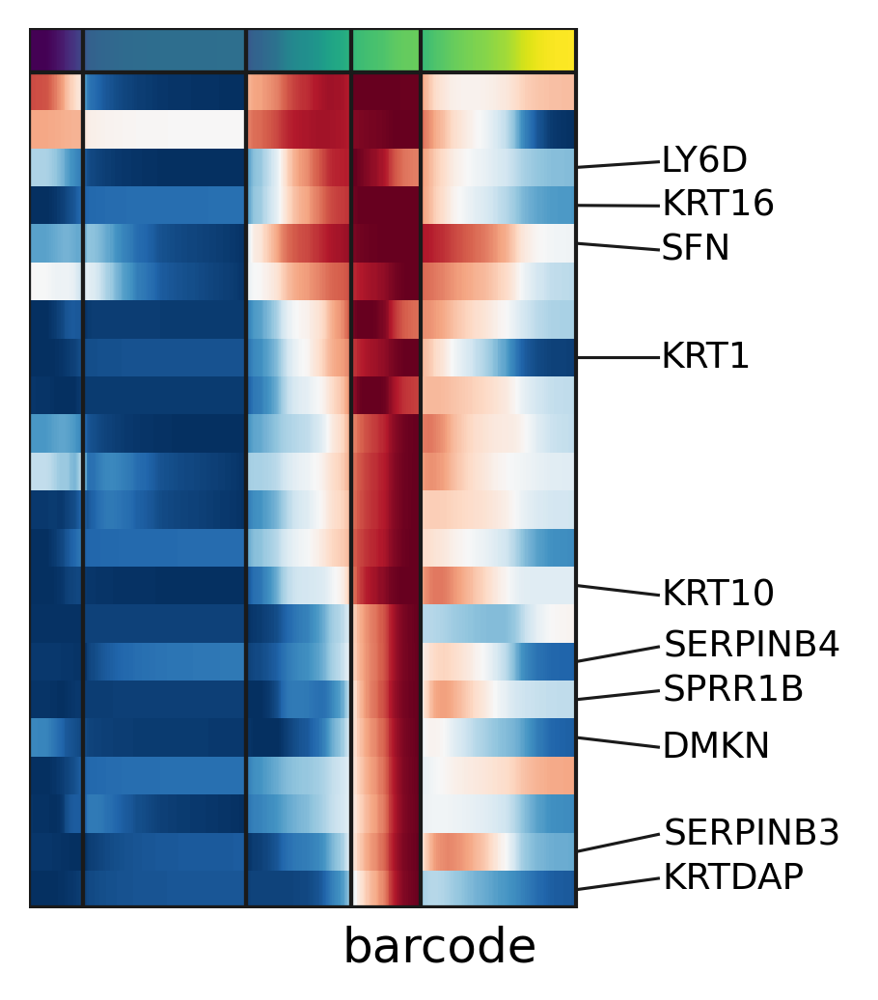

In [90]:
g2=scf.pl.trends(adata,
                 root_milestone="Root",
                 milestones=["mTECIII_KRT10hi", "mTECIII_MUC4", "mTECII"],
                 branch="mTECIII_KRT10hi",
                 plot_emb=False,ordering="max",return_genes=True)

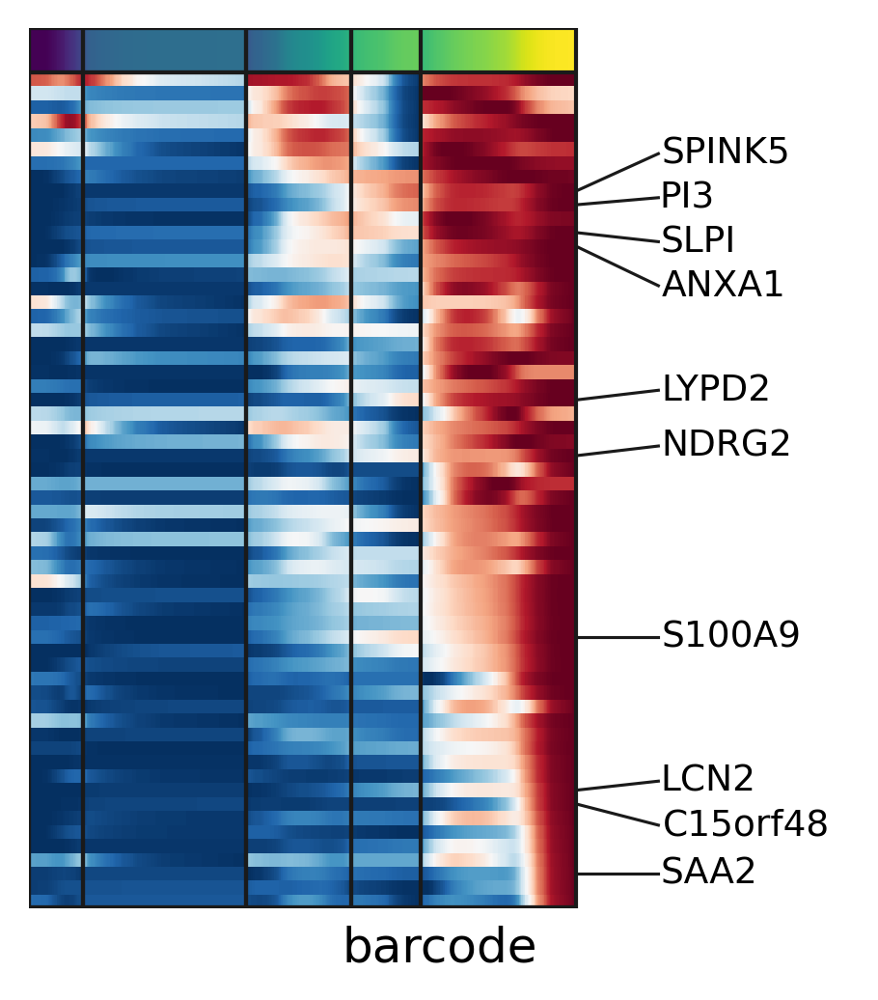

In [91]:
g3=scf.pl.trends(adata,
                 root_milestone="Root",
                 milestones=["mTECIII_KRT10hi", "mTECIII_MUC4", "mTECII"],
                 branch="mTECIII_MUC4",
                 plot_emb=False,ordering="max",return_genes=True)

In [92]:
gg=g1.tolist()+g2.tolist()+g3.tolist()

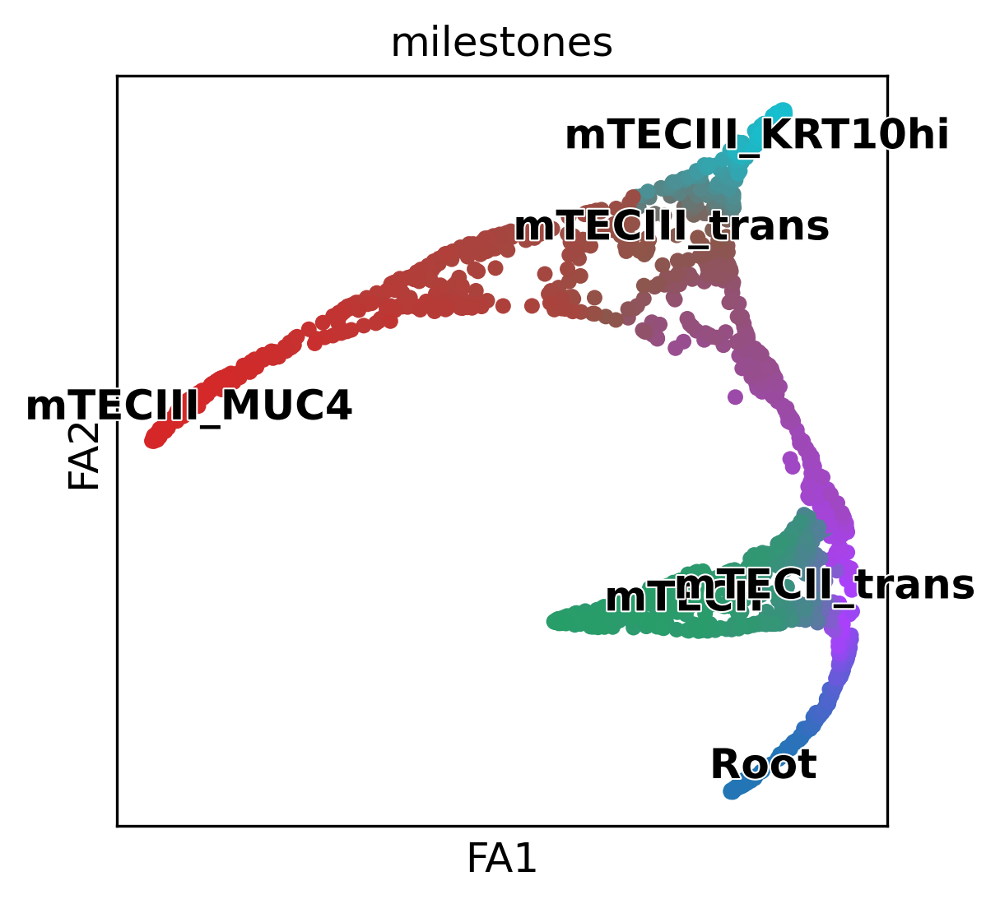

In [32]:
scf.pl.milestones(adata,annotate=True,  save = "mTECII_III_trajectory_annotated")

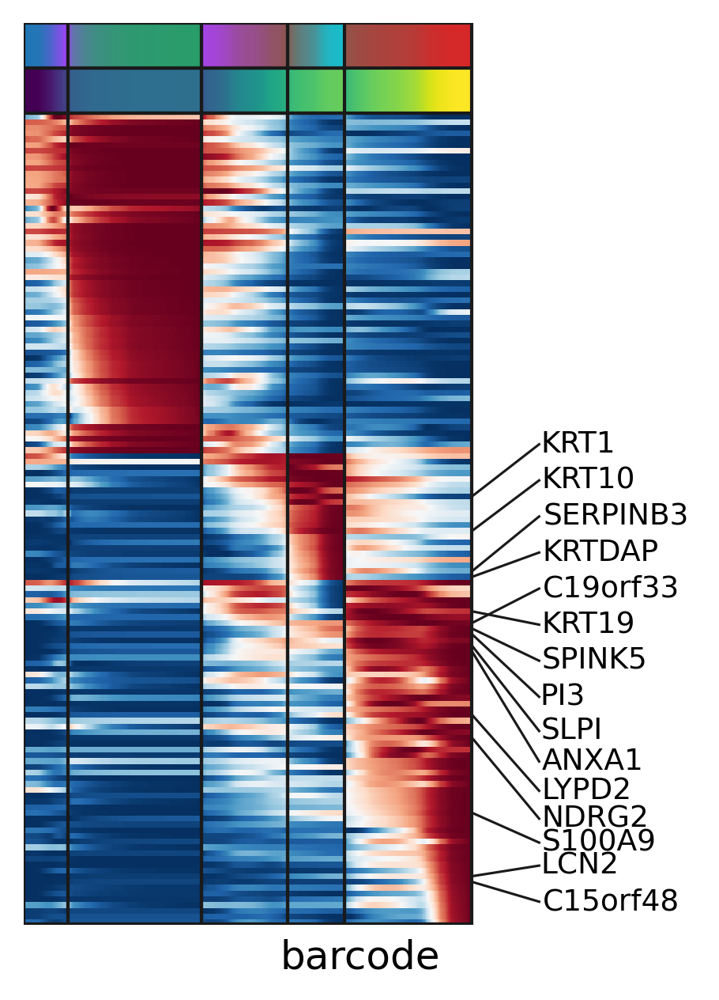

In [98]:
import matplotlib.pyplot as plt
g=scf.pl.trends(adata,gg,figsize=(4,5),annot="milestones",highlight_features  = "fdr", n_features=15,
        plot_emb=False,ordering=None,return_genes=True)
plt.savefig("figures/mTECII_III_traj_genes.pdf",dpi=300)

In [100]:
g.tolist()

['CCL25',
 'CTSS',
 'CHCHD10',
 'NOXO1',
 'LCP1',
 'NIT2',
 'CAPG',
 'CADPS',
 'CD83',
 'MARCKSL1',
 'HLA-DQB2',
 'SNX8',
 'TGFB1',
 'ARPC1B',
 'LAPTM5',
 'MARCO',
 'FCER2',
 'SRGN',
 'LINC00504',
 'GPX4',
 'TMSB10',
 'IL4I1',
 'CRIP1',
 'FLOT1',
 'IGKC',
 'EMP3',
 'FAHD2B',
 'CTSZ',
 'RHOF',
 'GAL',
 'TIMP1',
 'FABP6',
 'IQCG',
 'POMC',
 'NCF1',
 'MT2A',
 'CCDC150',
 'CD70',
 'PARVB',
 'DEFB4A',
 'NUB1',
 'CCK',
 'MIA',
 'GNG2',
 'EBI3',
 'CCR7',
 'SERPINB6',
 'CD86',
 'BCL2A1',
 'SLC15A3',
 'UPB1',
 'TFPI2',
 'CCL5',
 'CCL17',
 'CYSTM1',
 'MSC-AS1',
 'WARS',
 'IDO1',
 'S100A13',
 'KRT17',
 'BTG1',
 'LY6D',
 'KRT16',
 'SFN',
 'PYCARD',
 'PLA2G2F',
 'KRT1',
 'TMEM40',
 'CALML5',
 'GLTP',
 'ALDH3B2',
 'FABP5',
 'KRT10',
 'CHI3L2',
 'SERPINB4',
 'SPRR1B',
 'DMKN',
 'S100P',
 'PYDC1',
 'SERPINB3',
 'KRTDAP',
 'KRT8',
 'RHOC',
 'S100A2',
 'PLAC8',
 'SAT1',
 'KRT19',
 'IFITM3',
 'C19orf33',
 'SPINK5',
 'PI3',
 'UPK3BL1',
 'SLPI',
 'ANXA1',
 'ANXA2',
 'CTSV',
 'CXCL17',
 'KRT13',
 'MUC16',
 

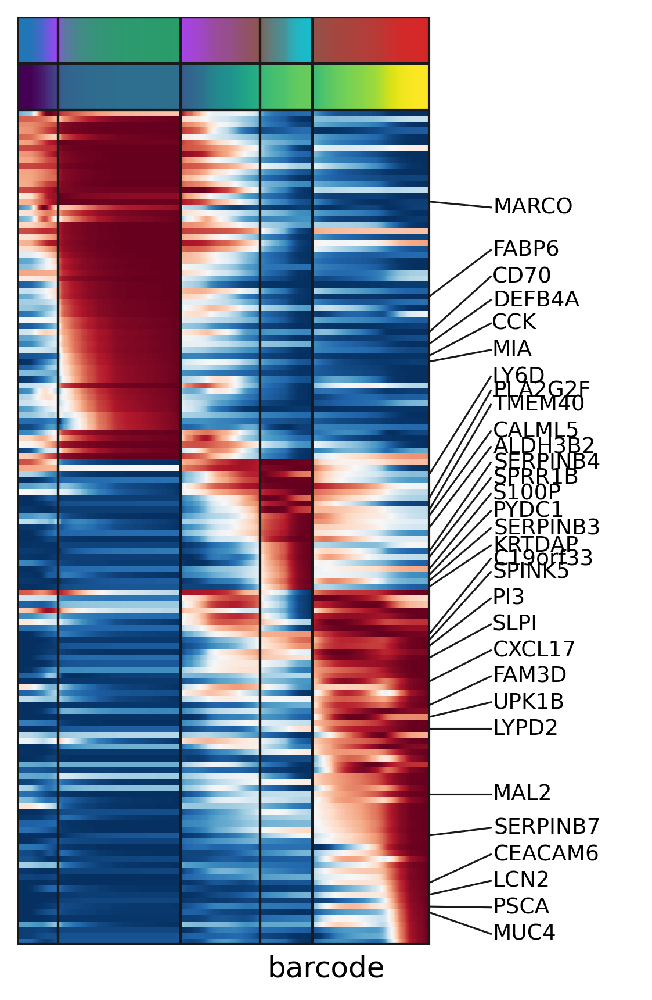

In [97]:
#import matplotlib.pyplot as plt
g=scf.pl.trends(adata,gg,figsize=(5,7),annot="milestones",highlight_features  = sge_de_branch, 
        plot_emb=False,ordering=None,return_genes=True)
plt.savefig("figures/mTECII_III_traj_SGE_highlighted.pdf",dpi=300)

In [65]:
g

Index(['CCL25', 'LCP1', 'CD83', 'SNX8', 'LAPTM5', 'MARCO', 'FCER2', 'SRGN',
       'IL4I1', 'CRIP1', 'IGKC', 'CTSZ', 'TIMP1', 'GAL', 'FABP6', 'NCF1',
       'MT2A', 'CD70', 'DEFB4A', 'MIA', 'BCL2A1', 'CCL5', 'CYSTM1', 'LY6D',
       'KRT16', 'SFN', 'KRT1', 'GLTP', 'FABP5', 'KRT10', 'SERPINB4', 'SPRR1B',
       'DMKN', 'PYDC1', 'SERPINB3', 'KRTDAP', 'KRT8', 'PLAC8', 'SAT1', 'KRT19',
       'PI3', 'UPK3BL1', 'SLPI', 'ANXA1', 'ANXA2', 'CXCL17', 'S100A4', 'FAM3D',
       'UPK1B', 'LYPD2', 'KRT18', 'S100A10', 'NDRG2', 'KRT7', 'CD24', 'S100A8',
       'TM4SF1', 'CEACAM6', 'MAL', 'LCN2', 'C15orf48', 'PSCA', 'SAA2'],
      dtype='object')